# Urban Heat in Berlin

This exercise ...


In [1]:
import os
import geopandas as gpd
import seaborn as sns
import cartopy.crs as ccrs
import rasterio
import rioxarray
import matplotlib.pyplot as plt

os.getcwd()

'd:\\gitscripts\\teaching\\teaching\\heat'

In [2]:
datafolder = "D:/Seafile/Meine Bibliothek/teaching/teaching-heat/data"
os.listdir(datafolder)


['city',
 'cooling-hours',
 'heatwave-magnitude-index',
 'HWMI_2011_2020_present_30.tif',
 'osm_water_berlin.gpkg',
 'tropical-nights',
 'wet-bulb-28']

In [3]:
districts = gpd.read_file(datafolder + "/city/Bezirksgrenzen.shp")
districts.explore("gem", tiles="CartoDB positron")

<AxesSubplot: >

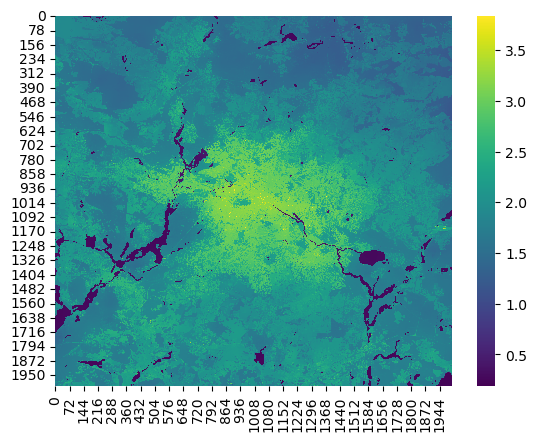

In [4]:
# load the raster file "HWMI_2011_2020_present_30.tif" and display it
# note that raster data requires the rasterio package
hwmi = rasterio.open(datafolder + "/HWMI_2011_2020_present_30.tif")
hwmi.read(1)
# display the raster data using matplotlib
#import matplotlib.pyplot as plt
#plt.imshow(hwmi.read(1), cmap="viridis")

# display the raster data using seaborn
sns.heatmap(hwmi.read(1), cmap="viridis")


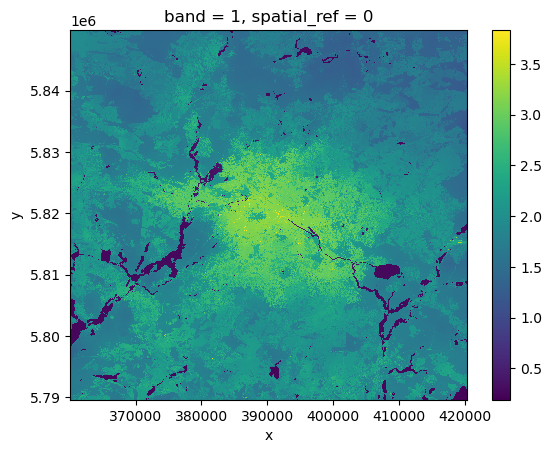

In [5]:
hwmi=rioxarray.open_rasterio(datafolder + "/HWMI_2011_2020_present_30.tif")
hwmi.plot()

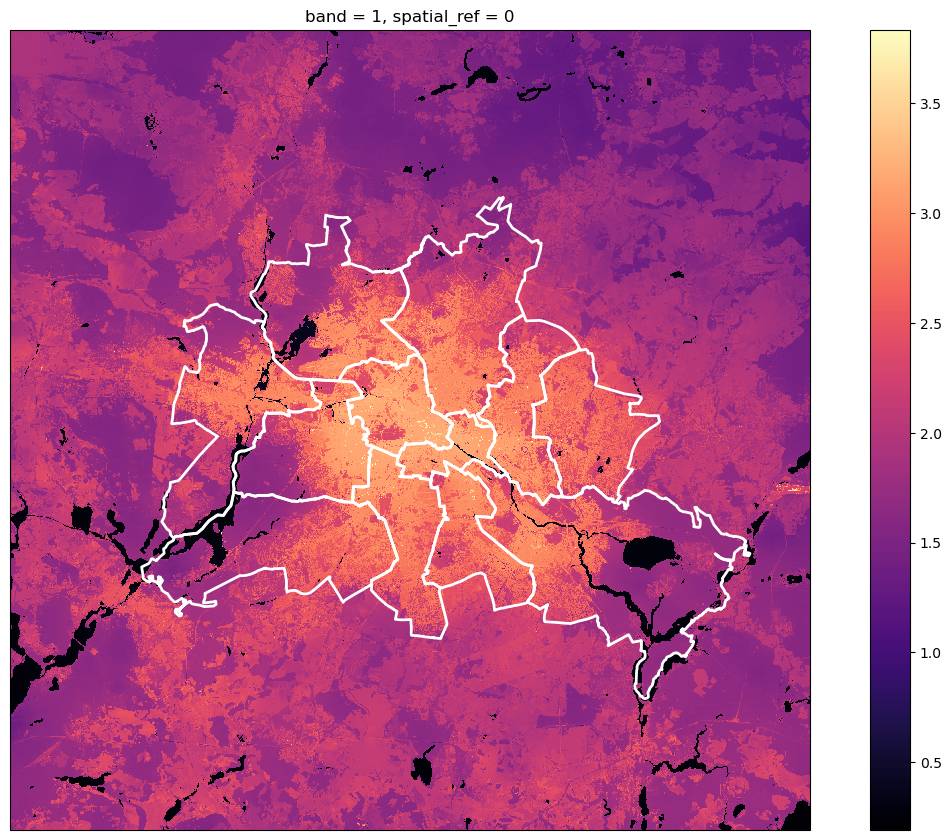

In [6]:
fig=plt.figure(figsize=[12,8])
ax = fig.add_axes([0,0,1,1],projection=ccrs.UTM(32))
raster_image=hwmi.plot(ax=ax, cmap="magma")
districts.plot(ax=ax,color='none', edgecolor="white",linewidth=2)
plt.show()

In [7]:
# extract the mean HWMI value for each district
districts["hwmi_mean"] = districts.geometry.apply(
    lambda geom: hwmi.sel(x=geom.centroid.x, y=geom.centroid.y, method="nearest").mean().item()
)
# display the districts with the mean HWMI value
districts.explore("hwmi_mean", tiles="CartoDB positron", cmap="viridis")


In [8]:
import geowombat as gw
with gw.open(datafolder + "/HWMI_2011_2020_present_30.tif") as src:
    df = gw.extract(src, datafolder + "/city/Bezirksgrenzen.shp")

df.rename(columns={1 : "hwmi_extracted"}, inplace=True)

# join the mean HWMI value to the districts GeoDataFrame
districts = districts.merge(df.groupby("gem").mean("hwmi_extracted").reset_index(), on="gem")

districts


d:\gitscripts\brandenburg-drought-study\.conda\lib\site-packages\tqdm\auto.py:22: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


,gem,namgem,namlan,lan,name,geometry,hwmi_mean,id,point,hwmi_extracted
0,003,Pankow,Berlin,11,11000003,"MULTIPOLYGON (((391281.076 5834094.026, 391278...",2.786919,0.0,57324.0,2.416582
1,009,Treptow-Köpenick,Berlin,11,11000009,"POLYGON ((413187.446 5812466.254, 413188.668 5...",1.811205,1.0,207781.0,1.954545
2,007,Tempelhof-Schöneberg,Berlin,11,11000007,"POLYGON ((390305.591 5804288.293, 390302.578 5...",2.870324,2.0,330370.0,2.720608
3,002,Friedrichshain-Kreuzberg,Berlin,11,11000002,"POLYGON ((394754.189 5820768.235, 394757.396 5...",3.163864,3.0,371149.5,2.939850
4,011,Lichtenberg,Berlin,11,11000011,"POLYGON ((399797.137 5827986.437, 399859.451 5...",2.847373,4.0,411410.5,2.674455
5,004,Charlottenburg-Wilmersdorf,Berlin,11,11000004,"POLYGON ((386007.534 5820640.410, 386013.008 5...",2.615367,5.0,476273.0,2.405335
6,010,Marzahn-Hellersdorf,Berlin,11,11000010,"POLYGON ((405800.725 5814456.489, 405787.202 5...",2.683085,6.0,546517.5,2.570552
7,005,Spandau,Berlin,11,11000005,"POLYGON ((379859.154 5825626.683, 379867.377 5...",2.845112,7.0,631872.0,2.192254
8,012,Reinickendorf,Berlin,11,11000012,"POLYGON ((386338.951 5832057.891, 386358.829 5...",2.917237,8.0,732506.0,2.223285
9,001,Mitte,Berlin,11,11000001,"POLYGON ((390097.493 5825221.615, 390102.570 5...",3.223138,9.0,803986.0,3.013970


In [9]:
districts.explore("hwmi_extracted", tiles="CartoDB positron", cmap="viridis")


### Grey-Blue-Green: Buildings, Roads, Water, and Parks

In the next step, we want to check how temperature differs with distance to urban land cover

1. Extract buildings, roads, water, parks, and tabulate heat distributions
2. Calculate distance decay / plot 
3. Train XGBoost to predict temperature
4. Inspect SHAP

In [ ]:
buildings = gpd.read_file(datafolder + "/city/Gebäudeflächen.shp")
buildings.explore()

In [ ]:
roads = gpd.read_file(datafolder + "/city/osm_major_roads_berlin.gpkg")
roads.explore("fclass", tiles="CartoDB positron")

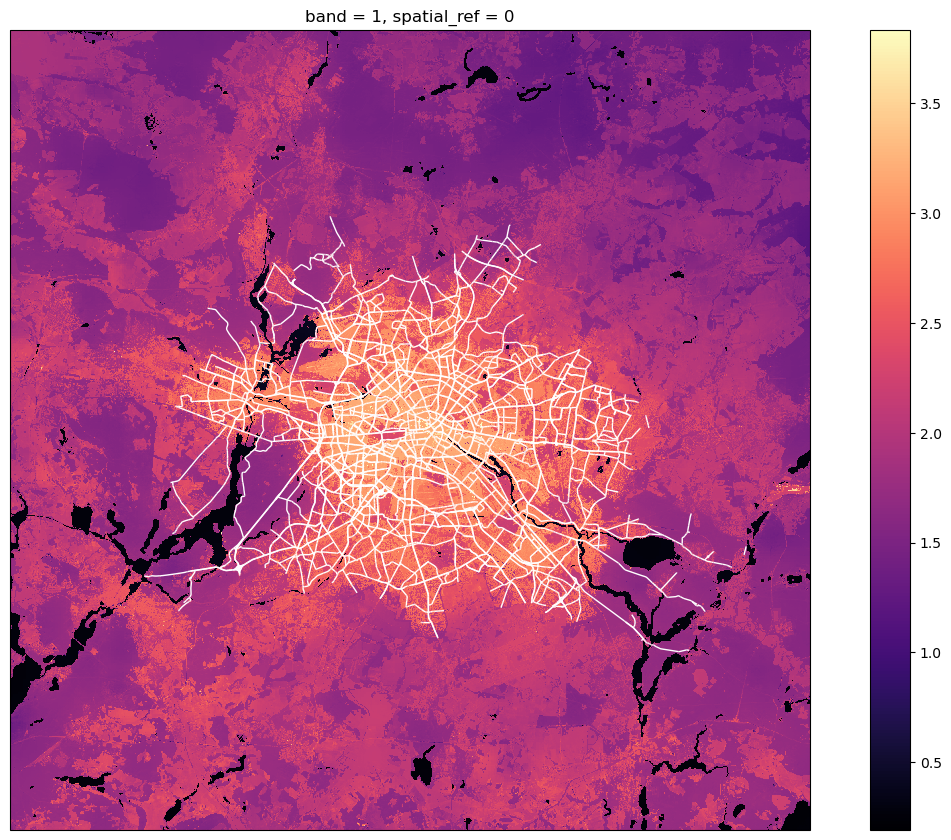

In [16]:
fig=plt.figure(figsize=[12,8])
ax = fig.add_axes([0,0,1,1],projection=ccrs.UTM(32))
raster_image=hwmi.plot(ax=ax, cmap="magma")
roads.plot(ax=ax,color='white', edgecolor="white",linewidth=1)
plt.show()

In [18]:
# extract the mean HWMI value for the roads
roads["hwmi_mean"] = roads.geometry.apply(
    lambda geom: hwmi.sel(x=geom.centroid.x, y=geom.centroid.y, method="nearest").mean().item()
)
# display the roads with the mean HWMI value
roads.explore("hwmi_mean", tiles="CartoDB positron", cmap="viridis")


In [19]:
# compute how hwmi values depend on spatial distance to the nearest road
from scipy.spatial import cKDTree   
# create a tree for the road geometries
road_tree = cKDTree(roads.geometry.apply(lambda geom: geom.centroid.coords[0]).tolist())
# compute the distance to the nearest road for each building
buildings["distance_to_road"] = buildings.geometry.apply(
    lambda geom: road_tree.query(geom.centroid.coords[0])[0]
)
# compute the mean HWMI value for each distance to the nearest road
buildings["hwmi_mean"] = buildings.geometry.apply(
    lambda geom: hwmi.sel(x=geom.centroid.x, y=geom.centroid.y, method="nearest").mean().item()
)
# group by distance to the nearest road and compute the mean HWMI value
distance_hwmi = buildings.groupby("distance_to_road")["hwmi_mean"].mean().reset_index()
# plot the mean HWMI value against the distance to the nearest road
plt.figure(figsize=(10, 6))
sns.lineplot(data=distance_hwmi, x="distance_to_road", y="hwmi_mean")
plt.title("Mean HWMI value vs. distance to nearest road")   
plt.xlabel("Distance to nearest road (m)")
plt.ylabel("Mean HWMI value")
# save the plot

KeyboardInterrupt: 

In [ ]:
# compute a distance to roads raster with the same resolution as the HWMI raster
from rasterio.features import rasterize
from rasterio.transform import from_origin
transform = hwmi.rio.transform()
road_raster = rasterize(
    [(geom, 1) for geom in roads.geometry],
    out_shape=hwmi.shape[1:],
    transform=transform,
    fill=0,
    all_touched=True
)

# this road_raster is a binary raster where 1 indicates the presence of a road and 0 indicates no road
# convert the binary raster to a distance raster
import numpy as np
from scipy.ndimage import distance_transform_edt
# compute the distance to the nearest road
road_raster = distance_transform_edt(road_raster == 0)  # invert the raster to compute distance from roads
# convert the distance raster to meters (assuming the raster is in UTM coordinates)
road_raster = road_raster * hwmi.rio.resolution()[0]  # convert pixels to meters
road_raster = road_raster.astype(np.float32)  # ensure the raster is in float32 format


# save the distance to roads raster
with rasterio.open(
    datafolder + "/distance_to_roads_30m_float.tif",
    "w",
    driver="GTiff",
    height=road_raster.shape[0],
    width=road_raster.shape[1],
    count=1,
    dtype=road_raster.dtype,
    crs=hwmi.rio.crs,
    transform=transform
) as dst:
    dst.write(road_raster, 1)





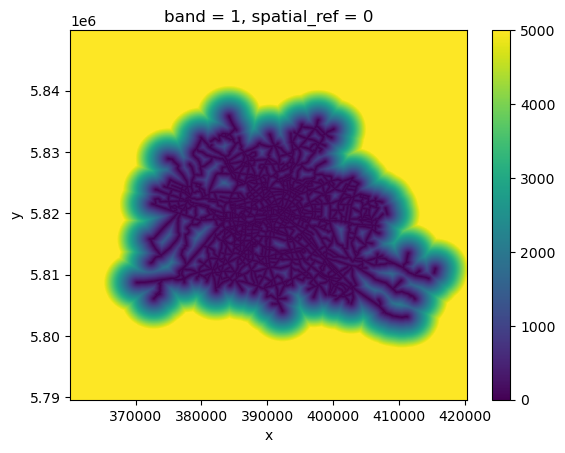

In [27]:
# load the distance to roads raster
distance_to_roads = rioxarray.open_rasterio(datafolder + "/distance_to_roads_30m_float.tif")
# display the distance to roads raster, with a maximum value of 5000 meters
distance_to_roads.clip(min=0, max=5000).plot(cmap="viridis")

Text(0, 0.5, 'Mean HWMI value')

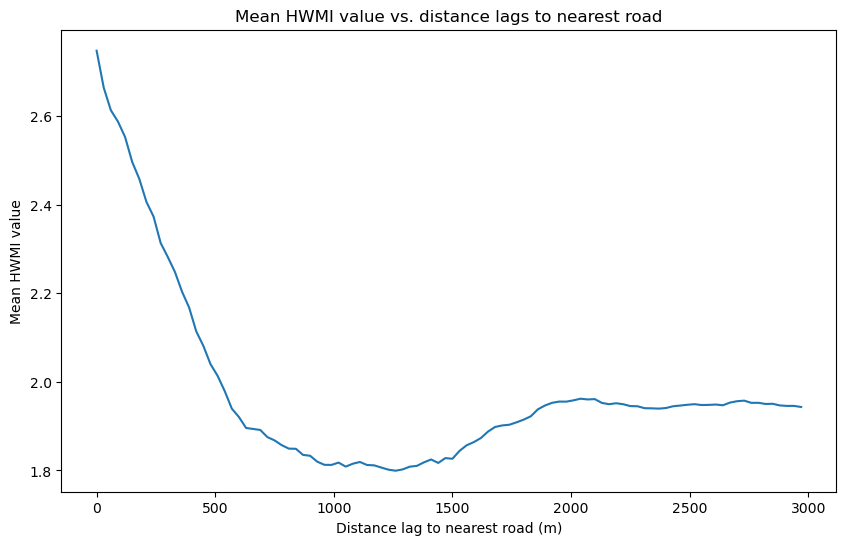

In [29]:

# compute the mean HWMI value for each distance lags to the nearest road
distance_lags = np.arange(0, 3000, 30)  # distance lags in meters
distance_hwmi = []
for lag in distance_lags:
    # create a mask for the distance to roads raster
    mask = (distance_to_roads >= lag) & (distance_to_roads < lag + 30)
    # compute the mean HWMI value for the masked area
    mean_hwmi = hwmi.where(mask).mean().item()
    distance_hwmi.append(mean_hwmi)

# plot the mean HWMI value against the distance lags
plt.figure(figsize=(10, 6))
sns.lineplot(x=distance_lags, y=distance_hwmi)
plt.title("Mean HWMI value vs. distance lags to nearest road")
plt.xlabel("Distance lag to nearest road (m)")
plt.ylabel("Mean HWMI value")